In [0]:
from pyspark.sql.functions import *

In [0]:
# File location and type
file_location = "/FileStore/tables/export.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
lc_df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(file_location)

display(lc_df)

term,home_ownership,grade,purpose,int_rate,installment,addr_state,loan_status,application_type,loan_amnt,emp_length,annual_inc,dti,delinq_2yrs,revol_bal,revol_util,total_acc,num_tl_90g_dpd_24m,dti_joint,term_cleaned,emplen_cleaned,revolutil_cleaned,rev_avg,dti_cleaned,bad_loan
36 months,RENT,G,other,30.84%,42.92,WA,Current,Individual,1000,6 years,31680.0,0.0,0,0,null,3,0,null,36.0,6,43.76206961077844,43.76206961077844,0.0,No
60 months,MORTGAGE,B,debt_consolidation,12.98%,682.29,NJ,Current,Individual,30000,10+ years,137000.0,12.87,0,23162,65.20%,31,0,null,60.0,10,65.0,43.76206961077844,12.87,No
60 months,MORTGAGE,A,credit_card,8.19%,346.25,MD,Current,Individual,17000,6 years,82000.0,15.57,0,16693,25.80%,17,0,null,60.0,6,25.0,43.76206961077844,15.57,No
36 months,RENT,B,debt_consolidation,10.72%,97.82,NJ,Current,Individual,3000,2 years,60000.0,12.46,1,586,39.10%,16,0,null,36.0,2,39.0,43.76206961077844,12.46,No
36 months,RENT,B,debt_consolidation,11.31%,789.26,IL,Current,Joint App,24000,2 years,74675.0,17.28,0,18469,44%,9,0,13.88,36.0,2,44.0,43.76206961077844,17.28,No
36 months,MORTGAGE,E,medical,23.40%,194.6,TX,Current,Individual,5000,10+ years,75000.0,8.16,0,16274,51.80%,13,0,null,36.0,10,51.0,43.76206961077844,8.16,No
36 months,MORTGAGE,A,debt_consolidation,8.19%,817.03,MI,Current,Individual,26000,n/a,88000.0,33.92,0,8698,56.10%,57,0,null,36.0,null,56.0,43.76206961077844,33.92,No
36 months,MORTGAGE,B,other,11.80%,165.6,CA,Current,Individual,5000,10+ years,100000.0,17.88,2,4093,17.20%,29,0,null,36.0,10,17.0,43.76206961077844,17.88,No
36 months,RENT,C,debt_consolidation,16.14%,436.81,VA,Current,Individual,12400,n/a,25764.0,38.33,0,10315,75.30%,11,0,null,36.0,null,75.0,43.76206961077844,38.33,No
60 months,MORTGAGE,C,debt_consolidation,16.14%,975.71,DE,Current,Individual,40000,10+ years,390000.0,9.14,0,57115,73%,28,0,null,60.0,10,73.0,43.76206961077844,9.14,No


In [0]:
display(lc_df.describe())

summary,term,home_ownership,grade,purpose,int_rate,installment,addr_state,loan_status,application_type,loan_amnt,emp_length,annual_inc,dti,delinq_2yrs,revol_bal,revol_util,total_acc,num_tl_90g_dpd_24m,dti_joint,term_cleaned,emplen_cleaned,revolutil_cleaned,rev_avg,dti_cleaned,bad_loan
count,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,128412,116708,128412,128412,128412,128412
mean,null,null,null,null,null,463.26122083605605,null,null,null,15971.32102139987,null,82797.32786094757,19.933177530719707,0.22783696227766875,16898.000957854405,null,22.677413325857398,0.059488209824626985,19.22660231200095,43.51948416035884,5.609821091955992,43.76206961077844,43.76206961077533,19.93087850045166,null
stddev,null,null,null,null,null,285.71837061496973,null,null,null,10150.384232741917,null,108298.46579150076,20.1435422434755,0.7337929617806043,24082.550912035425,null,12.129215673024762,0.41065173659442405,8.141631264595574,11.132202965983444,3.6776295739511067,24.786779696453962,0.0,20.12807970280373,null
min,36 months,ANY,A,car,10.08%,30.48,AK,Charged Off,Individual,1000,1 year,0.0,0.0,0,0,0%,2,0,0.0,36.0,1,0.0,43.76206961077844,0.0,No
max,60 months,RENT,G,vacation,8.81%,1618.24,WY,Late (31-120 days),Joint App,40000,n/a,9757200.0,null,24,2358150,null,160,23,null,60.0,10,183.0,43.76206961077844,999.0,Yes


In [0]:
lc_df.createOrReplaceTempView("lc_loan_data")

In [0]:
%sql

SELECT addr_state, sum(loan_amnt) FROM lc_loan_data GROUP BY addr_state 

addr_state,sum(loan_amnt)
SC,26727325
AZ,48675775
LA,20446175
MN,32531850
NJ,77727025
DC,4579000
OR,23525900
VA,57595925
RI,9891700
KY,19158625


Databricks visualization. Run in Databricks to view.

In [0]:
display(lc_df.groupBy("addr_state").agg((count(col("annual_inc"))).alias("count")))

addr_state,count
SC,1692
AZ,3149
LA,1328
MN,2078
NJ,4711
DC,274
OR,1562
VA,3364
RI,614
KY,1280


Databricks visualization. Run in Databricks to view.

In [0]:
%sql

select addr_state, count(loan_amnt) from lc_loan_data where bad_loan = 'Yes' group by addr_state order by count(loan_amnt) desc

addr_state,count(loan_amnt)
CA,284
NY,177
FL,153
TX,146
PA,72
MD,60
GA,60
NC,55
VA,54
MI,51


Databricks visualization. Run in Databricks to view.

California is the state with the bigger number of bad loans.

In [0]:
%sql

SELECT grade, count(loan_amnt) AS total_custumers FROM lc_loan_data GROUP BY grade ORDER BY grade

grade,total_custumers
A,38011
B,35861
C,31018
D,17072
E,5962
F,387
G,101


Databricks visualization. Run in Databricks to view.

In [0]:
%sql

SELECT grade, sum(loan_amnt) AS tot_loan_amnt FROM lc_loan_data GROUP BY grade ORDER BY grade

grade,tot_loan_amnt
A,604816200
B,591596125
C,495916925
D,267034700
E,83832000
F,6326275
G,1387050


Databricks visualization. Run in Databricks to view.

People with higher scores borrow more money.

In [0]:
%sql

select grade, bad_loan, sum(loan_amnt) as tot_loan_amnt from lc_loan_data group by grade, bad_loan ORDER BY grade, bad_loan desc

grade,bad_loan,tot_loan_amnt
A,Yes,3148050
A,No,601668150
B,Yes,7033600
B,No,584562525
C,Yes,8643900
C,No,487273025
D,Yes,7226725
D,No,259807975
E,Yes,3624800
E,No,80207200


Databricks visualization. Run in Databricks to view.

Across each grade we can see the total amount of the loan of the bad and god loans. As we can see the G grade as the bigger percentage of bad loans.

In [0]:
# If the loan is good the value given corresponds to the revol_bal, if the loan id bad the value giver is revol_bal * -10 - its negative - we are multiplying by 10 just to make it noticeable in the plots 
# revol_bal - is the balance the custumer owns in all his accounts
lc_df = lc_df.withColumn("exposure", when(lc_df.bad_loan == "No", col("revol_bal")).otherwise(-10 * col("revol_bal")))
display(lc_df)

term,home_ownership,grade,purpose,int_rate,installment,addr_state,loan_status,application_type,loan_amnt,emp_length,annual_inc,dti,delinq_2yrs,revol_bal,revol_util,total_acc,num_tl_90g_dpd_24m,dti_joint,term_cleaned,emplen_cleaned,revolutil_cleaned,rev_avg,dti_cleaned,bad_loan,exposure
36 months,RENT,G,other,30.84%,42.92,WA,Current,Individual,1000,6 years,31680.0,0.0,0,0,null,3,0,null,36.0,6,43.76206961077844,43.76206961077844,0.0,No,0
60 months,MORTGAGE,B,debt_consolidation,12.98%,682.29,NJ,Current,Individual,30000,10+ years,137000.0,12.87,0,23162,65.20%,31,0,null,60.0,10,65.0,43.76206961077844,12.87,No,23162
60 months,MORTGAGE,A,credit_card,8.19%,346.25,MD,Current,Individual,17000,6 years,82000.0,15.57,0,16693,25.80%,17,0,null,60.0,6,25.0,43.76206961077844,15.57,No,16693
36 months,RENT,B,debt_consolidation,10.72%,97.82,NJ,Current,Individual,3000,2 years,60000.0,12.46,1,586,39.10%,16,0,null,36.0,2,39.0,43.76206961077844,12.46,No,586
36 months,RENT,B,debt_consolidation,11.31%,789.26,IL,Current,Joint App,24000,2 years,74675.0,17.28,0,18469,44%,9,0,13.88,36.0,2,44.0,43.76206961077844,17.28,No,18469
36 months,MORTGAGE,E,medical,23.40%,194.6,TX,Current,Individual,5000,10+ years,75000.0,8.16,0,16274,51.80%,13,0,null,36.0,10,51.0,43.76206961077844,8.16,No,16274
36 months,MORTGAGE,A,debt_consolidation,8.19%,817.03,MI,Current,Individual,26000,n/a,88000.0,33.92,0,8698,56.10%,57,0,null,36.0,null,56.0,43.76206961077844,33.92,No,8698
36 months,MORTGAGE,B,other,11.80%,165.6,CA,Current,Individual,5000,10+ years,100000.0,17.88,2,4093,17.20%,29,0,null,36.0,10,17.0,43.76206961077844,17.88,No,4093
36 months,RENT,C,debt_consolidation,16.14%,436.81,VA,Current,Individual,12400,n/a,25764.0,38.33,0,10315,75.30%,11,0,null,36.0,null,75.0,43.76206961077844,38.33,No,10315
60 months,MORTGAGE,C,debt_consolidation,16.14%,975.71,DE,Current,Individual,40000,10+ years,390000.0,9.14,0,57115,73%,28,0,null,60.0,10,73.0,43.76206961077844,9.14,No,57115


In [0]:
display(lc_df.groupBy("grade", "bad_loan").agg({"exposure": "sum"}).orderBy("grade"))

grade,bad_loan,sum(exposure)
A,Yes,-36651160
A,No,678252010
B,No,602056854
B,Yes,-68627150
C,Yes,-81097340
C,No,498293640
D,Yes,-65796390
D,No,260026379
E,Yes,-37537880
E,No,94498504


Databricks visualization. Run in Databricks to view.

Even though Grade G was considered to have the highest number of bad loans in the previous graphs, here Grade C and B are the ones with the worst results because we are considering them in relation to the total balance and there are more clients in Grade C and B than in the final Grade.

In [0]:
display(lc_df.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in lc_df.columns]))

term,home_ownership,grade,purpose,int_rate,installment,addr_state,loan_status,application_type,loan_amnt,emp_length,annual_inc,dti,delinq_2yrs,revol_bal,revol_util,total_acc,num_tl_90g_dpd_24m,dti_joint,term_cleaned,emplen_cleaned,revolutil_cleaned,rev_avg,dti_cleaned,bad_loan,exposure
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,11704,0,0,0,0,0


In [0]:
%sql

select loan_amnt from lc_loan_data

loan_amnt
1000
30000
17000
3000
24000
5000
26000
5000
12400
40000


Databricks visualization. Run in Databricks to view.

In [0]:
%sql

select loan_amnt, bad_loan from lc_loan_data

loan_amnt,bad_loan
1000,No
30000,No
17000,No
3000,No
24000,No
5000,No
26000,No
5000,No
12400,No
40000,No


Databricks visualization. Run in Databricks to view.

When the loan is good the loan amount is typically aroun 13k, when is bad the loan amount is around 15k.

In [0]:
%sql
select loan_amnt from lc_loan_data where bad_loan = 'Yes'

loan_amnt
2000
32000
14400
11500
20000
4000
15000
35000
18500
22500


Databricks visualization. Run in Databricks to view.

In [0]:
from pyspark.sql.types import FloatType

def trim(string):
    return string.strip('%')

# With udf we can use the function in a distriuted way
spark.udf.register("trimperct", trim) # Got a new name

Out[27]: <function __main__.trim(string)>

In [0]:
%sql
select int_rate, cast(trimperct(int_rate) as float) as int_rate_float from lc_loan_data

int_rate,int_rate_float
30.84%,30.84
12.98%,12.98
8.19%,8.19
10.72%,10.72
11.31%,11.31
23.40%,23.4
8.19%,8.19
11.80%,11.8
16.14%,16.14
16.14%,16.14


In [0]:
%sql

select bad_loan, cast(trimperct(int_rate) as float) as int_rate_float from lc_loan_data

bad_loan,int_rate_float
No,30.84
No,12.98
No,8.19
No,10.72
No,11.31
No,23.4
No,8.19
No,11.8
No,16.14
No,16.14


In [0]:
%sql

select bad_loan, installment from lc_loan_data

bad_loan,installment
No,42.92
No,682.29
No,346.25
No,97.82
No,789.26
No,194.6
No,817.03
No,165.6
No,436.81
No,975.71


In [0]:
%sql

select home_ownership, bad_loan, loan_amnt from lc_loan_data 

home_ownership,bad_loan,loan_amnt
RENT,No,1000
MORTGAGE,No,30000
MORTGAGE,No,17000
RENT,No,3000
RENT,No,24000
MORTGAGE,No,5000
MORTGAGE,No,26000
MORTGAGE,No,5000
RENT,No,12400
MORTGAGE,No,40000


Databricks visualization. Run in Databricks to view.

In [0]:
%sql

select grade, purpose, count(*) as count from lc_loan_data group by grade, purpose

grade,purpose,count
B,moving,156
D,credit_card,2849
F,home_improvement,30
D,renewable_energy,9
C,renewable_energy,13
A,credit_card,14177
E,renewable_energy,4
F,house,7
A,medical,314
C,moving,179


Databricks visualization. Run in Databricks to view.

We can see the majority of the loans are for debt consolidation in all of the Grades. In Grade A a big percentage also get loans for credit cards while in Grade G a big percentage get a loan for other situation not mentioned.

In [0]:
display(lc_df.groupBy('grade', 'loan_status').agg({'loan_status':'count'}))

grade,loan_status,count(loan_status)
E,Fully Paid,360
B,Late (16-30 days),78
A,In Grace Period,74
C,Late (31-120 days),234
C,Fully Paid,1175
E,Late (16-30 days),46
F,Fully Paid,36
E,In Grace Period,54
F,Late (16-30 days),9
A,Current,36639


Databricks visualization. Run in Databricks to view.

Most of the loans are current but in Grade G we can see that 7% of the loans are late (31 to 120 days), while in Grade A ther are no late payments.

In [0]:
%sql
select bad_loan, count(*) from lc_loan_data group by bad_loan

bad_loan,count(1)
No,126584
Yes,1828


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
select installment, loan_amnt, bad_loan from lc_loan_data

installment,loan_amnt,bad_loan
42.92,1000,No
682.29,30000,No
346.25,17000,No
97.82,3000,No
789.26,24000,No
194.6,5000,No
817.03,26000,No
165.6,5000,No
436.81,12400,No
975.71,40000,No


Databricks visualization. Run in Databricks to view.

In [0]:
lc_df.stat.corr('installment', 'loan_amnt')

Out[38]: 0.9398702873916219

The variables 'installment' and 'loan_amnt' are highly positivly correlated.

In [0]:
pd_df = lc_df.toPandas()

/databricks/python/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


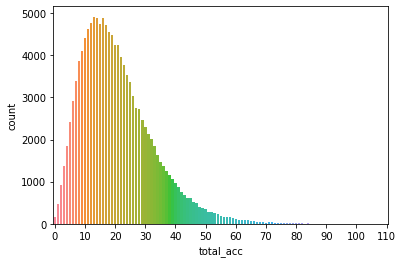

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
plt.clf()
sns.countplot(pd_df.loc[pd_df['total_acc']<120,'total_acc'],order=sorted(pd_df['total_acc'].unique()), saturation=1)
_, _ = plt.xticks(np.arange(0, 120, 10), np.arange(0, 120, 10))
plt.xlabel('total_acc')
plt.ylabel('count')
display()